ANALYSIS OF PROPERTIES OF PRODUCTS IN ROUND 2


In [21]:
import sys
import os
import pandas as pd
import plotly.graph_objects as go
import plotly.express as px


current_dir = os.getcwd()
print(f"Current working directory: {current_dir}")


project_root = os.path.abspath(os.path.join(current_dir, '..'))


if os.path.basename(current_dir) == 'analysis' and os.path.basename(os.path.dirname(current_dir)) == 'notebooks':
    project_root = os.path.abspath(os.path.join(current_dir, '..', '..'))
elif os.path.basename(current_dir) == 'notebooks&analysis':
     project_root = os.path.abspath(os.path.join(current_dir, '..'))

print(f"Attempting to use project root: {project_root}")


if project_root not in sys.path:
    sys.path.insert(0, project_root) 
    print(f"Added project root to sys.path.")
else:
    print(f"Project root already in sys.path.")


dashboard_path = os.path.join(project_root, 'dashboard')
print(f"Looking for dashboard directory at: {dashboard_path}")
if not os.path.isdir(dashboard_path):
    print(f"WARNING: 'dashboard' directory not found at expected location.")


try:

    from dashboard.historical_data_loader import load_historical_data
    print("Successfully imported load_historical_data from dashboard.historical_data_loader")
except ImportError as e:
    print(f"\nError importing load_historical_data: {e}")
    print("Please ensure:")
    print(f"1. The calculated project root is correct: {project_root}")
    print(f"2. A directory named 'dashboard' exists directly under the project root.")
    print(f"3. 'historical_data_loader.py' exists inside the 'dashboard' directory.")
    print(f"4. The 'dashboard' directory has an empty '__init__.py' file if needed (usually automatically handled).")




HISTORICAL_DATA_DIR = 'C:/Users/Admin/projects/prosperity-poj/strategy/round2/resources/round2' 
PRODUCTS_TO_ANALYZE = ["CROISSANTS", "JAMS", "DJEMBES"]


try:
    from historical_data_loader import load_historical_data
    print(f"Loading historical data from: {HISTORICAL_DATA_DIR}")
    historical_data = load_historical_data(HISTORICAL_DATA_DIR)
    print(f"Loaded data for days: {list(historical_data.keys())}")
except ImportError as e:
    print(f"Error importing historical_data_loader: {e}")
    print("Please ensure 'historical_data_loader.py' exists in the 'dashboard' directory")
    print(f"Attempted import from: {dashboard_dir}")
    historical_data = {} 
except Exception as e:
    print(f"An error occurred during data loading: {e}")
    historical_data = {}

if not historical_data:
    print("No historical data loaded, cannot generate plots.")
else:
    for day, day_data in historical_data.items():
        print(f"\n--- Plotting Day {day} ---")
        prices_df = day_data.get('prices')

        if prices_df is None or prices_df.empty:
            print(f"  No price data found for Day {day}.")
            continue

        
        prices_df['timestamp'] = pd.to_numeric(prices_df['timestamp'], errors='coerce')
        prices_df.dropna(subset=['timestamp'], inplace=True)
        prices_df = prices_df.sort_values(by='timestamp').reset_index(drop=True)

        for product in PRODUCTS_TO_ANALYZE:
            product_prices = prices_df[prices_df['product'] == product].copy()

            if product_prices.empty:
                print(f"  No data for {product} on Day {day}.")
                continue

            print(f"  Generating plot for {product}...")
            fig = go.Figure()

            
            for col, name, color, dash in [
                ('bid_price_1', 'Best Bid', 'lightgreen', None),
                ('ask_price_1', 'Best Ask', 'lightcoral', None),
                ('mid_price', 'Mid Price', 'lightblue', 'dash')
            ]:
                if col in product_prices.columns:
                    
                    numeric_series = pd.to_numeric(product_prices[col], errors='coerce').ffill().bfill()
                    if not numeric_series.isnull().all(): 
                        fig.add_trace(go.Scatter(
                            x=product_prices['timestamp'],
                            y=numeric_series,
                            mode='lines', name=name,
                            line=dict(color=color, dash=dash)
                        ))
                else:
                    print(f"    Warning: Column '{col}' not found for {product} on Day {day}.")


            fig.update_layout(
                title=f'{product} Prices - Day {day}',
                xaxis_title='Timestamp',
                yaxis_title='Price',
                template='plotly_dark', 
                hovermode='x unified',
                legend_title_text='Price Type'
            )
            fig.show()


Current working directory: c:\Users\Admin\projects\prosperity-poj\notebooks&analysis
Attempting to use project root: c:\Users\Admin\projects\prosperity-poj
Project root already in sys.path.
Looking for dashboard directory at: c:\Users\Admin\projects\prosperity-poj\dashboard
Successfully imported load_historical_data from dashboard.historical_data_loader
Loading historical data from: C:/Users/Admin/projects/prosperity-poj/strategy/round2/resources/round2
Loading historical data for Round 2 from: C:/Users/Admin/projects/prosperity-poj/strategy/round2/resources/round2
  Loaded prices for day -1 from prices_round_2_day_-1.csv
  Loaded trades for day -1 from trades_round_2_day_-1_nn.csv
  Loaded prices for day 0 from prices_round_2_day_0.csv
  Loaded trades for day 0 from trades_round_2_day_0_nn.csv
  Loaded prices for day 1 from prices_round_2_day_1.csv
  Loaded trades for day 1 from trades_round_2_day_1_nn.csv
Loaded data for days: [-1, 0, 1]

--- Plotting Day -1 ---
  Generating plot for

  Generating plot for JAMS...


  Generating plot for DJEMBES...



--- Plotting Day 0 ---
  Generating plot for CROISSANTS...


  Generating plot for JAMS...


  Generating plot for DJEMBES...



--- Plotting Day 1 ---
  Generating plot for CROISSANTS...


  Generating plot for JAMS...


  Generating plot for DJEMBES...


BID-ASK SPREAD

In [22]:


import pandas as pd
import plotly.graph_objects as go
import plotly.express as px



PRODUCTS_TO_PLOT = ["CROISSANTS", "JAMS", "DJEMBES"]


if 'historical_data' not in locals() or not isinstance(historical_data, dict) or not historical_data:
    print("Error: 'historical_data' dictionary not found or empty.")
    print("Please ensure you have successfully run the first cell that loads historical data.")
    raise NameError("historical_data not found. Run the previous cell.")

DAYS_TO_COMBINE = sorted([day for day in historical_data.keys() if 'prices' in historical_data.get(day, {})]) 

combined_prices_df = pd.DataFrame()
valid_days_loaded = []

print("Combining price data from loaded days...")
for day in DAYS_TO_COMBINE:
    if day in historical_data and 'prices' in historical_data[day] and isinstance(historical_data[day]['prices'], pd.DataFrame):
        day_prices = historical_data[day]['prices'].copy()
        day_prices['timestamp'] = pd.to_numeric(day_prices['timestamp'], errors='coerce')
        day_prices.dropna(subset=['timestamp'], inplace=True)
        day_prices['day'] = day
        combined_prices_df = pd.concat([combined_prices_df, day_prices], ignore_index=True)
        valid_days_loaded.append(day)
    else:
        print(f"Warning: Price data for day {day} not found, is not a DataFrame, or not loaded correctly.")

if combined_prices_df.empty:
    print("Error: No price data available to plot spreads after combining days.")
else:
    print(f"Combined price data from days: {valid_days_loaded}")
    combined_prices_df.sort_values(by=['product', 'day', 'timestamp'], inplace=True)

    # --- Plot Bid-Ask Spread Time Series ---
    print("\nGenerating Bid-Ask Spread Plots...")

    required_cols = ['product', 'timestamp', 'ask_price_1', 'bid_price_1', 'day']
    if not all(col in combined_prices_df.columns for col in required_cols):
        print(f"Error: Missing one or more required columns in combined_prices_df: {required_cols}")
        missing_cols = [col for col in required_cols if col not in combined_prices_df.columns]
        print(f"Missing: {missing_cols}")
    else:
        for product in PRODUCTS_TO_PLOT:
            # Filter for the product
            product_prices = combined_prices_df[combined_prices_df['product'] == product].copy()

            if product_prices.empty:
                print(f"No price data found for {product} in the combined data.")
                continue

            product_prices['ask_price_1'] = pd.to_numeric(product_prices['ask_price_1'], errors='coerce')
            product_prices['bid_price_1'] = pd.to_numeric(product_prices['bid_price_1'], errors='coerce')

            # Calculate spread
            product_prices['spread'] = product_prices['ask_price_1'] - product_prices['bid_price_1']

            product_prices.dropna(subset=['timestamp', 'spread'], inplace=True)

            if product_prices.empty:
                print(f"No valid spread data points found for {product} after cleaning.")
                continue

            
            fig_spread = go.Figure()

            
            available_days_for_product = sorted(product_prices['day'].unique())
            for day in available_days_for_product:
                 day_data = product_prices[product_prices['day'] == day]
                 fig_spread.add_trace(go.Scattergl(
                     x=day_data['timestamp'],
                     y=day_data['spread'],
                     mode='lines',
                     name=f'Day {day}',
                     line=dict(width=1.5)
                 ))

            fig_spread.update_layout(
                title=f'{product} - Historical Bid-Ask Spread (Days: {available_days_for_product})',
                xaxis_title='Timestamp (per day)',
                yaxis_title='Spread (Ask Price 1 - Bid Price 1)',
                hovermode='x unified',
                template='plotly_dark',
                legend_title_text='Day'
            )

            valid_spreads = product_prices['spread'].dropna()
            if not valid_spreads.empty and valid_spreads.min() >= 0:
                 fig_spread.update_yaxes(rangemode='tozero')

            print(f"Displaying spread plot for {product}...")
            fig_spread.show()

print("\nSpread plot generation complete.")


Combining price data from loaded days...
Combined price data from days: [-1, 0, 1]

Generating Bid-Ask Spread Plots...
Displaying spread plot for CROISSANTS...


Displaying spread plot for JAMS...


Displaying spread plot for DJEMBES...



Spread plot generation complete.


CORRELATION


In [23]:
import pandas as pd
import numpy as np # For NaN handling if needed
import plotly.graph_objects as go
import plotly.express as px

# --- Check if combined_prices_df exists ---
if 'combined_prices_df' not in locals() or combined_prices_df.empty:
    print("Error: 'combined_prices_df' not found or empty.")
    print("Please ensure you have successfully run the previous cells.")
    # Stop execution if data is missing
    raise NameError("combined_prices_df not found. Run the previous cells.")

print("Calculating correlations for all available products using existing mid_price...")

# --- Prepare Data for Correlation ---

# 1. Ensure necessary columns exist
# We now rely on the pre-calculated 'mid_price'
required_cols = ['product', 'day', 'timestamp', 'mid_price']
if not all(col in combined_prices_df.columns for col in required_cols):
    print(f"Error: Missing one or more required columns in combined_prices_df: {required_cols}")
    missing_cols = [col for col in required_cols if col not in combined_prices_df.columns]
    print(f"Missing: {missing_cols}")
    # Stop if essential columns are missing
    raise KeyError("Missing essential columns for correlation calculation.")
else:
    # Convert mid_price to numeric, coercing errors, just in case
    combined_prices_df['mid_price'] = pd.to_numeric(combined_prices_df['mid_price'], errors='coerce')

    # Drop rows where essential columns are missing
    prices_cleaned_df = combined_prices_df.dropna(subset=['timestamp', 'mid_price', 'product', 'day']).copy()

    if prices_cleaned_df.empty:
        print("Error: No valid mid-price data points found after cleaning.")
        raise ValueError("No data left after cleaning for mid-price.")
    else:
        # 2. Pivot to Wide Format (Index: Day + Timestamp, Columns: Products, Values: Mid-Price)
        # Create a unique index combining day and timestamp
        prices_cleaned_df['datetime_index'] = prices_cleaned_df['day'].astype(str) + '_' + prices_cleaned_df['timestamp'].astype(str)
        prices_pivot_df = prices_cleaned_df.pivot_table(
            index='datetime_index', # Use combined index
            columns='product',
            values='mid_price' # Use the existing mid_price column
        )

        # 3. Calculate Returns (Simple Difference)
        returns_df = prices_pivot_df.diff().dropna(how='all') # Drop rows where all returns are NaN

        if returns_df.empty:
            print("Error: No valid returns data points found after calculation.")
            raise ValueError("Could not calculate returns.")
        else:
            # --- Calculate and Visualize Correlation Matrix ---
            print(f"Calculating correlation matrix for products: {list(returns_df.columns)}")
            correlation_matrix = returns_df.corr()

            print("\nCorrelation Matrix:")
            print(correlation_matrix.round(3)) # Print rounded matrix

            # Visualize using Plotly heatmap
            fig_corr = px.imshow(
                correlation_matrix,
                text_auto=True, # Display correlation values
                aspect="auto",
                color_continuous_scale='RdBu_r', # Red-Blue diverging scale
                zmin=-1, zmax=1 # Ensure scale covers full range
            )

            fig_corr.update_layout(
                title='Product Mid-Price Return Correlation Matrix (Round 2 Data)',
                xaxis_title='Product',
                yaxis_title='Product',
                template='plotly_dark'
            )

            print("\nDisplaying correlation heatmap...")
            fig_corr.show()



Calculating correlations for all available products using existing mid_price...
Calculating correlation matrix for products: ['CROISSANTS', 'DJEMBES', 'JAMS', 'KELP', 'PICNIC_BASKET1', 'PICNIC_BASKET2', 'RAINFOREST_RESIN', 'SQUID_INK']

Correlation Matrix:
product           CROISSANTS  DJEMBES   JAMS   KELP  PICNIC_BASKET1  \
product                                                               
CROISSANTS             1.000    0.641  0.673 -0.385           0.775   
DJEMBES                0.641    1.000  0.810 -0.291           0.645   
JAMS                   0.673    0.810  1.000 -0.428           0.733   
KELP                  -0.385   -0.291 -0.428  1.000          -0.376   
PICNIC_BASKET1         0.775    0.645  0.733 -0.376           1.000   
PICNIC_BASKET2         0.703    0.446  0.643 -0.669           0.750   
RAINFOREST_RESIN      -0.005   -0.001  0.002 -0.003          -0.000   
SQUID_INK              0.529    0.479  0.622 -0.278           0.233   

product           PICNIC_BASKET2

MOMENTUM FOR CROISSANTS

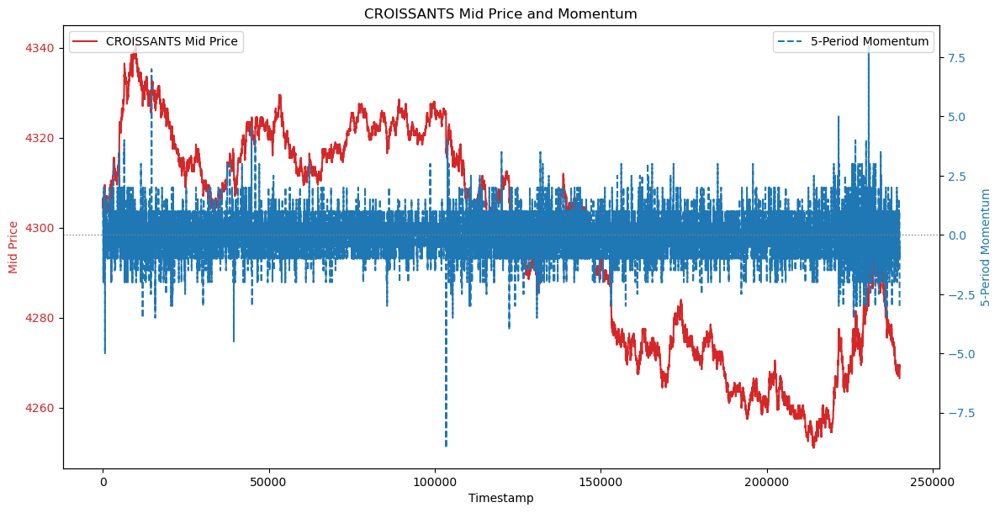

In [30]:


croissants_mid_price = combined_prices_df[combined_prices_df['product'] == 'CROISSANTS']['mid_price']
momentum_period = 5
croissants_momentum = croissants_mid_price.diff(periods=momentum_period)

# Plot momentum alongside price
import matplotlib.pyplot as plt

fig, ax1 = plt.subplots(figsize=(12, 6))

color = 'tab:red'
ax1.set_xlabel('Timestamp')
ax1.set_ylabel('Mid Price', color=color)
ax1.plot(croissants_mid_price.index, croissants_mid_price, color=color, label='CROISSANTS Mid Price')
ax1.tick_params(axis='y', labelcolor=color)
ax1.legend(loc='upper left')

ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
color = 'tab:blue'
ax2.set_ylabel(f'{momentum_period}-Period Momentum', color=color)
ax2.plot(croissants_momentum.index, croissants_momentum, color=color, linestyle='--', label=f'{momentum_period}-Period Momentum')
ax2.tick_params(axis='y', labelcolor=color)
ax2.axhline(0, color='grey', linestyle=':', linewidth=1) # Add zero line for momentum
ax2.legend(loc='upper right')

fig.tight_layout()
plt.title('CROISSANTS Mid Price and Momentum')
plt.show()


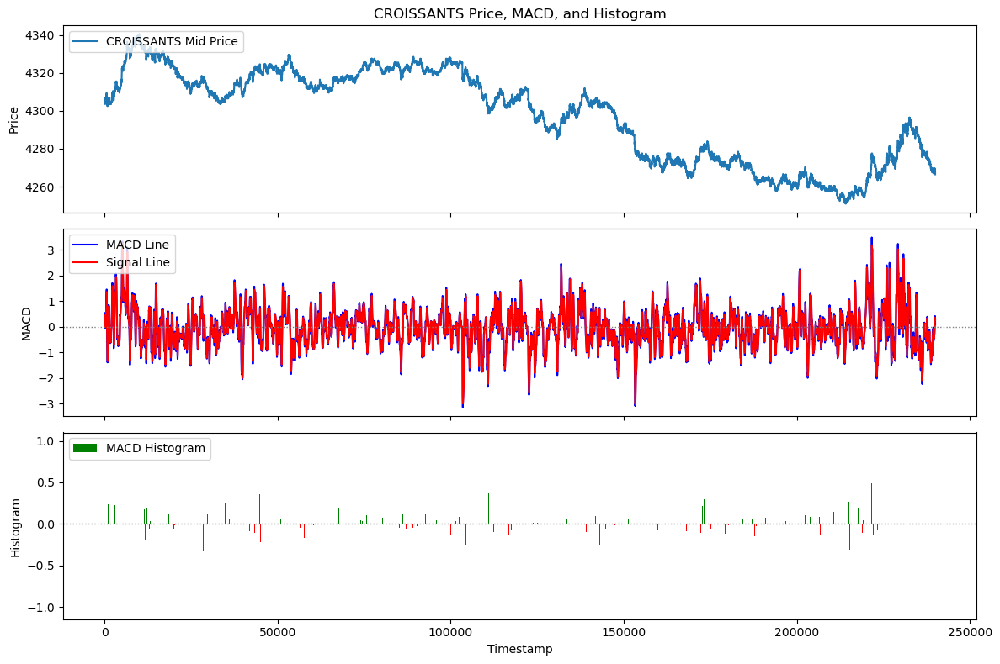

In [25]:
# Calculate EMAs
short_ema = croissants_mid_price.ewm(span=20, adjust=False).mean()
long_ema = croissants_mid_price.ewm(span=60, adjust=False).mean()

# Calculate MACD line and Signal line
macd_line = short_ema - long_ema
signal_line = macd_line.ewm(span=9, adjust=False).mean()

# Calculate MACD Histogram
macd_histogram = macd_line - signal_line

# Plotting
plt.figure(figsize=(12, 8))

# Price Plot
ax_price = plt.subplot(3, 1, 1)
plt.plot(croissants_mid_price.index, croissants_mid_price, label='CROISSANTS Mid Price')
plt.title('CROISSANTS Price, MACD, and Histogram')
plt.ylabel('Price')
plt.legend(loc='upper left')
plt.setp(ax_price.get_xticklabels(), visible=False) # Hide x-axis labels for upper plots

# MACD Plot
ax_macd = plt.subplot(3, 1, 2, sharex=ax_price)
plt.plot(macd_line.index, macd_line, label='MACD Line', color='blue')
plt.plot(signal_line.index, signal_line, label='Signal Line', color='red')
plt.ylabel('MACD')
plt.legend(loc='upper left')
plt.axhline(0, color='grey', linestyle=':', linewidth=1)
plt.setp(ax_macd.get_xticklabels(), visible=False)

# Histogram Plot
ax_hist = plt.subplot(3, 1, 3, sharex=ax_price)
colors = ['green' if val >= 0 else 'red' for val in macd_histogram]
plt.bar(macd_histogram.index, macd_histogram, label='MACD Histogram', color=colors)
plt.ylabel('Histogram')
plt.xlabel('Timestamp')
plt.legend(loc='upper left')
plt.axhline(0, color='grey', linestyle=':', linewidth=1)

plt.tight_layout()
plt.show()

In [31]:
import statsmodels.api as sm
future_price_change = croissants_mid_price.diff().shift(-1) # Price(t+1) - Price(t)


df = pd.DataFrame({
    'Momentum': croissants_momentum,
    'FutureChange': future_price_change
})
df = df.dropna()


X = df['Momentum']
y = df['FutureChange']


X = sm.add_constant(X)


model = sm.OLS(y, X)
results = model.fit()


print("--- CROISSANTS Momentum Regression ---")
print(results.summary())



momentum_coef = results.params.get('Momentum', np.nan)
momentum_pval = results.pvalues.get('Momentum', np.nan)

print("\n--- Interpretation Summary ---")
if not np.isnan(momentum_coef) and not np.isnan(momentum_pval):
    if momentum_coef > 0 and momentum_pval < 0.05:
        print("Result: Found a statistically significant POSITIVE relationship.")
        print("        This supports the momentum hypothesis (past momentum predicts future price change in the same direction).")
    elif momentum_coef < 0 and momentum_pval < 0.05:
        print("Result: Found a statistically significant NEGATIVE relationship.")
        print("        This suggests mean reversion, CONTRARY to the momentum hypothesis.")
    else:
        print("Result: No statistically significant relationship found (p-value >= 0.05 or coefficient near zero).")
        print("        The momentum hypothesis is not strongly supported by this specific test.")
else:
    print("Could not extract coefficient or p-value.")

print(f"Momentum Coefficient: {momentum_coef:.4f}")
print(f"Momentum P-value: {momentum_pval:.4f}")
print(f"R-squared: {results.rsquared:.4f}")

--- CROISSANTS Momentum Regression ---
                            OLS Regression Results                            
Dep. Variable:           FutureChange   R-squared:                       0.004
Model:                            OLS   Adj. R-squared:                  0.004
Method:                 Least Squares   F-statistic:                     121.1
Date:                Sat, 12 Apr 2025   Prob (F-statistic):           4.08e-28
Time:                        01:30:55   Log-Likelihood:                -13829.
No. Observations:               29994   AIC:                         2.766e+04
Df Residuals:                   29992   BIC:                         2.768e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        

CROSSAINTS BB

In [34]:
import plotly.graph_objects as go
import numpy as np 


window_cr = 20
std_devs_cr = 2

# Calculate rolling mean and standard deviation
rolling_mean_cr = croissants_mid_price.rolling(window=window_cr).mean()
rolling_std_cr = croissants_mid_price.rolling(window=window_cr).std()

# Calculate upper and lower bands
upper_band_cr = rolling_mean_cr + (rolling_std_cr * std_devs_cr)
lower_band_cr = rolling_mean_cr - (rolling_std_cr * std_devs_cr)

# Create the interactive plot
fig = go.Figure()

# Add Mid Price
fig.add_trace(go.Scatter(x=croissants_mid_price.index, y=croissants_mid_price,
                         mode='lines',
                         name='CROISSANTS Mid Price',
                         line=dict(color='blue')))

# Add Rolling Mean
fig.add_trace(go.Scatter(x=rolling_mean_cr.index, y=rolling_mean_cr,
                         mode='lines',
                         name=f'{window_cr}-Period Moving Avg',
                         line=dict(color='orange', dash='dash')))

# Add Upper Band
fig.add_trace(go.Scatter(x=upper_band_cr.index, y=upper_band_cr,
                         mode='lines',
                         name=f'Upper Band ({std_devs_cr} std)',
                         line=dict(color='red', dash='dot'),
                         ))

# Add Lower Band (and fill)
fig.add_trace(go.Scatter(x=lower_band_cr.index, y=lower_band_cr,
                         mode='lines',
                         name=f'Lower Band ({std_devs_cr} std)',
                         line=dict(color='green', dash='dot'),
                         fill='tonexty', # Fill area between lower and upper band trace
                         fillcolor='rgba(128,128,128,0.1)' # Light grey fill
                         ))


fig.update_layout(
    title=f'CROISSANTS Mid Price and Bollinger Bands (Window={window_cr}, StdDevs={std_devs_cr}) - Interactive',
    xaxis_title='Timestamp',
    yaxis_title='Price',
    legend_title='Legend',
    hovermode='x unified' 
)

fig.show()


BOLLINGER BANDS FOR JAMS

In [32]:
jams_mid_price = combined_prices_df[combined_prices_df['product'] == 'JAMS']['mid_price']
import plotly.graph_objects as go
import pandas as pd 

window = 20 
std_devs = 2 

# Calculate rolling mean and standard deviation
rolling_mean = jams_mid_price.rolling(window=window).mean()
rolling_std = jams_mid_price.rolling(window=window).std()

# Calculate upper and lower bands
upper_band = rolling_mean + (rolling_std * std_devs)
lower_band = rolling_mean - (rolling_std * std_devs)

# Create the interactive plot
fig = go.Figure()

# Add Mid Price
fig.add_trace(go.Scatter(x=jams_mid_price.index, y=jams_mid_price,
                         mode='lines',
                         name='JAMS Mid Price',
                         line=dict(color='blue')))

# Add Rolling Mean
fig.add_trace(go.Scatter(x=rolling_mean.index, y=rolling_mean,
                         mode='lines',
                         name=f'{window}-Period Moving Avg',
                         line=dict(color='orange', dash='dash')))

# Add Upper Band
fig.add_trace(go.Scatter(x=upper_band.index, y=upper_band,
                         mode='lines',
                         name=f'Upper Band ({std_devs} std)',
                         line=dict(color='red', dash='dot'),
                         ))

# Add Lower Band (and fill)
fig.add_trace(go.Scatter(x=lower_band.index, y=lower_band,
                         mode='lines',
                         name=f'Lower Band ({std_devs} std)',
                         line=dict(color='green', dash='dot'),
                         fill='tonexty', # Fill area between lower and upper band trace
                         fillcolor='rgba(128,128,128,0.1)' # Light grey fill
                         ))


fig.update_layout(
    title=f'JAMS Mid Price and Bollinger Bands (Window={window}, StdDevs={std_devs}) - Interactive',
    xaxis_title='Timestamp',
    yaxis_title='Price',
    legend_title='Legend',
    hovermode='x unified' # Show hover info for all traces at a given x-value
)

fig.show()

In [41]:

# --- Parameters ---
window = 20      
std_devs = 2.5     
k_lookahead = 1  

rolling_mean = jams_mid_price.rolling(window=window).mean()
rolling_std = jams_mid_price.rolling(window=window).std()
upper_band = rolling_mean + (rolling_std * std_devs)
lower_band = rolling_mean - (rolling_std * std_devs)

is_above_upper = jams_mid_price > upper_band
is_below_lower = jams_mid_price < lower_band
is_outside = is_above_upper | is_below_lower


crossed_above_upper = is_above_upper & ~is_above_upper.shift(1).fillna(False)
crossed_below_lower = is_below_lower & ~is_below_lower.shift(1).fillna(False)


upper_cross_indices = crossed_above_upper[crossed_above_upper].index
lower_cross_indices = crossed_below_lower[crossed_below_lower].index

# --- Check for Reversion ---
total_upper_crossings = len(upper_cross_indices)
total_lower_crossings = len(lower_cross_indices)
reverted_from_upper = 0
reverted_from_lower = 0


for idx in upper_cross_indices:
    
    check_idx = idx + (k_lookahead * 100)

    
    if check_idx in jams_mid_price.index and check_idx in rolling_mean.index:
        
        if jams_mid_price.loc[check_idx] < rolling_mean.loc[check_idx]:
            reverted_from_upper += 1
    


for idx in lower_cross_indices:
    
    check_idx = idx + (k_lookahead * 100)

    
    if check_idx in jams_mid_price.index and check_idx in rolling_mean.index:
        
        if jams_mid_price.loc[check_idx] > rolling_mean.loc[check_idx]:
            reverted_from_lower += 1
    s


reversion_rate_upper = (reverted_from_upper / total_upper_crossings) if total_upper_crossings > 0 else 0
reversion_rate_lower = (reverted_from_lower / total_lower_crossings) if total_lower_crossings > 0 else 0
total_crossings = total_upper_crossings + total_lower_crossings
total_reversions = reverted_from_upper + reverted_from_lower
overall_reversion_rate = (total_reversions / total_crossings) if total_crossings > 0 else 0

print(f"--- JAMS Bollinger Band Reversion Analysis (k={k_lookahead}) ---")
print(f"Total Upper Band Crossings: {total_upper_crossings}")
print(f"Reverted Towards Mean After Upper Crossing: {reverted_from_upper} ({reversion_rate_upper:.2%})")
print(f"Total Lower Band Crossings: {total_lower_crossings}")
print(f"Reverted Towards Mean After Lower Crossing: {reverted_from_lower} ({reversion_rate_lower:.2%})")
print(f"Overall Reversion Rate within {k_lookahead} steps: {overall_reversion_rate:.2%}")


--- JAMS Bollinger Band Reversion Analysis (k=1) ---
Total Upper Band Crossings: 382
Reverted Towards Mean After Upper Crossing: 6 (1.57%)
Total Lower Band Crossings: 401
Reverted Towards Mean After Lower Crossing: 8 (2.00%)
Overall Reversion Rate within 1 steps: 1.79%


C:\Users\Admin\AppData\Local\Temp\ipykernel_13796\2826585363.py:21: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`

C:\Users\Admin\AppData\Local\Temp\ipykernel_13796\2826585363.py:22: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`



DJEMBES RSI-ZSCORES

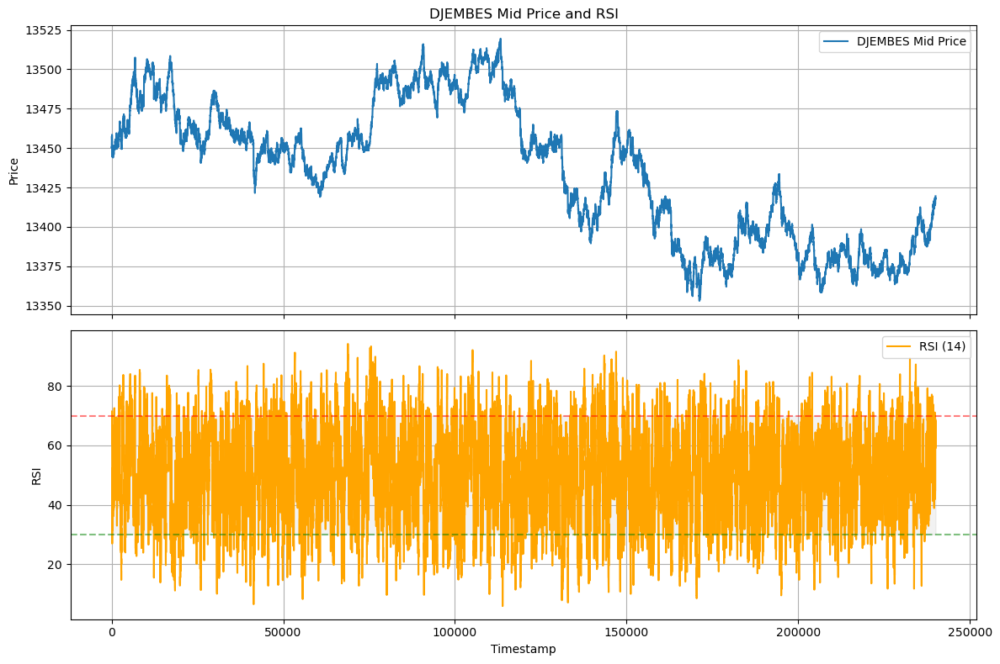

In [28]:
djembes_mid_price = combined_prices_df[combined_prices_df['product'] == 'DJEMBES']['mid_price']
rsi_window = 14 


delta = djembes_mid_price.diff()

gain = delta.where(delta > 0, 0).fillna(0)
loss = -delta.where(delta < 0, 0).fillna(0)

avg_gain = gain.ewm(com=rsi_window - 1, min_periods=rsi_window).mean()
avg_loss = loss.ewm(com=rsi_window - 1, min_periods=rsi_window).mean()


rs = avg_gain / avg_loss
rsi = 100 - (100 / (1 + rs))


fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 8), sharex=True)


ax1.plot(djembes_mid_price.index, djembes_mid_price, label='DJEMBES Mid Price')
ax1.set_ylabel('Price')
ax1.set_title('DJEMBES Mid Price and RSI')
ax1.legend()
ax1.grid(True)


ax2.plot(rsi.index, rsi, label=f'RSI ({rsi_window})', color='orange')
ax2.axhline(70, linestyle='--', color='red', alpha=0.5) # Overbought threshold
ax2.axhline(30, linestyle='--', color='green', alpha=0.5) # Oversold threshold
ax2.fill_between(rsi.index, 70, 30, color='grey', alpha=0.1)
ax2.set_ylabel('RSI')
ax2.set_xlabel('Timestamp')
ax2.legend()
ax2.grid(True)

plt.tight_layout()
plt.show()